In [9]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scanpy as sc
import anndata as ad
import scipy.sparse as sp
from matplotlib import rcParams
import glob
import gc
import sys
from nichecompass.models import NicheCompass
from matplotlib.colors import ListedColormap, to_rgb, to_hex
import os

In [52]:
dataset = 'nanostring_cosmx_human_nsclc'
# model = 'reference_query_mapping'
model = 'reference'

# Visualize models one by one

In [50]:
def load_model(suffix, cluster=False, latent_leiden_resolution=0.5):
    model_folder = glob.glob(f'../../../artifacts/{dataset}/models/{model}/*_{suffix}')[0]
    adata = sc.read_h5ad(f"{model_folder}/{dataset}_{model}.h5ad")
    adata.obs_names = adata.obs['cell_ID'].values
    adata.obs['cell type'] = adata.obs['cell_type_original'].map({
        'tumor 9': 'tumor', 'tumor 6': 'tumor', 'tumor 5': 'tumor', 'tumor 13': 'tumor', 'tumor 12': 'tumor',
        'fibroblast': 'fibroblast', 'neutrophil': 'neutrophil', 'plasmablast': 'plasmablast', 'B-cell': 'B-cell', 'endothelial': 'endothelial', 'epithelial': 'epithelial',
        'T CD4 naive': 'T cell/NK', 'T CD4 memory': 'T cell/NK', 'T CD8 naive': 'T cell/NK', 'T CD8 memory': 'T cell/NK', 'Treg': 'T cell/NK', 'NK': 'T cell/NK',
        'mDC': 'DC/monocyte', 'pDC': 'DC/monocyte', 'monocyte': 'DC/monocyte', 'macrophage': 'macrophage', 'mast': 'mast'
    }).astype("category")
    adata.uns['cell type_colors'] = np.apply_along_axis(to_hex, 1, np.array(plt.get_cmap('tab20').colors))[[6,10,2,14,4,5,0,1,8,12,18]]
    adata.uns['cell type_colors'][3] = '#ffff33'
    adata.uns['mapping_entity_colors'] = ['#00AFBB', '#999999']
    adata.obs['cell type'] = adata.obs['cell type'].cat.reorder_categories(['tumor','fibroblast','endothelial','epithelial','macrophage','DC/monocyte','B-cell','plasmablast', 'T cell/NK', 'mast', 'neutrophil'], ordered=False)
    sc.pl.umap(adata, color=['batch','cell type','niche','mapping_entity'], ncols=4, wspace=0.5, size=0.5)
    
    if model == 'reference_query_mapping':
        new_batches = adata.obs.loc[adata.obs.mapping_entity == 'query','batch'].unique()
        sc.pl.umap(adata[adata.obs.mapping_entity == 'reference'], color=['batch','cell type','niche'], ncols=4, wspace=0.5, size=0.5)
        sc.pl.umap(adata[adata.obs.batch != new_batches[1]], color=['mapping_entity','cell type','niche'], ncols=4, wspace=0.5, size=0.5)
        sc.pl.umap(adata[adata.obs.batch != new_batches[0]], color=['mapping_entity','cell type','niche'], ncols=4, wspace=0.5, size=0.5)

    if cluster:
        if not f"latent_leiden_{str(latent_leiden_resolution)}" in adata.obs.columns:
            sc.tl.leiden(adata, resolution=latent_leiden_resolution, key_added=f"latent_leiden_{str(latent_leiden_resolution)}", neighbors_key="nichecompass_latent")
            adata.write_h5ad(f"{model_folder}/{dataset}_{model}.h5ad") # re-write file with new metadata  
        
        # Plot sample 5 for fov effects
        for b in adata.obs.loc[adata.obs['patient']=='Lung5','batch'].unique():
            sc.pl.embedding(adata[adata.obs.batch==b], basis="spatial", color=['cell type', f"latent_leiden_{str(latent_leiden_resolution)}"], ncols=2, wspace=0.3, size=3)    
    
    adata = NicheCompass.load(dir_path=model_folder,
                          adata=adata,
                          gp_names_key='nichecompass_gp_names')
    
    # check number of active gps
    active_gps = model.get_active_gps()
    print(f"{len(active_gps)} active GPs out of {len(adata.adata.uns['nichecompass_gp_names'])} total GPs.")
    
    gc.collect()
    return adata

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/pyth

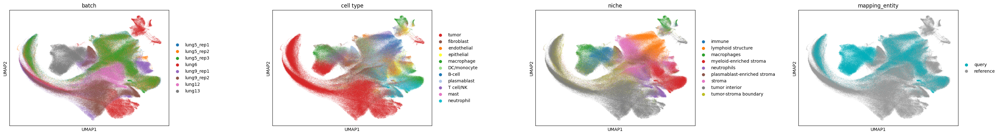

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


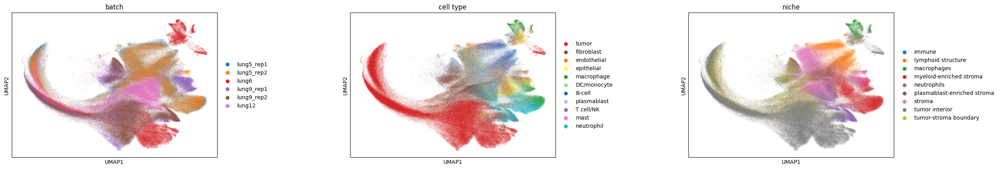

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


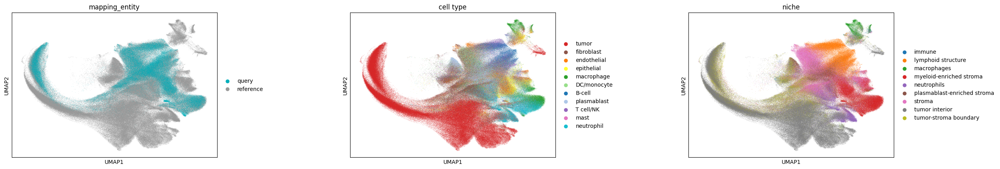

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


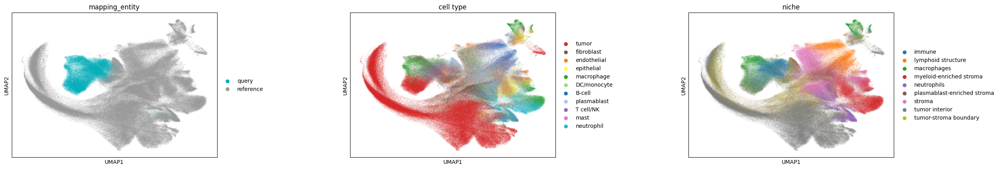

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.01
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1494, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960


In [4]:
# 13 (grey), 5 (green)
madata = load_model('101')

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/pyth

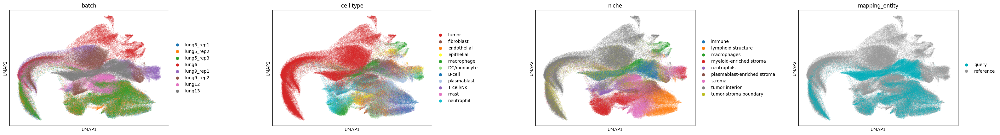

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


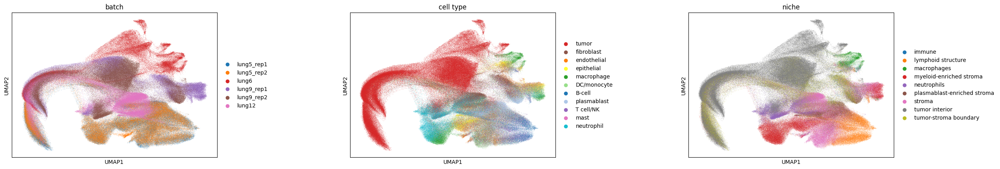

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


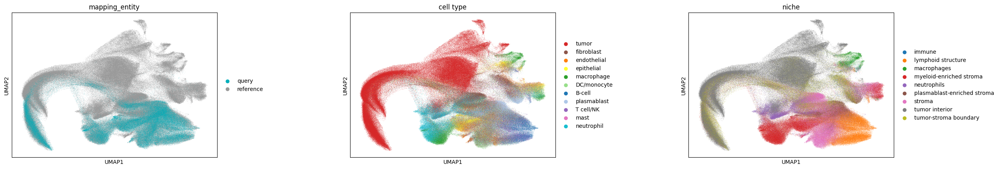

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


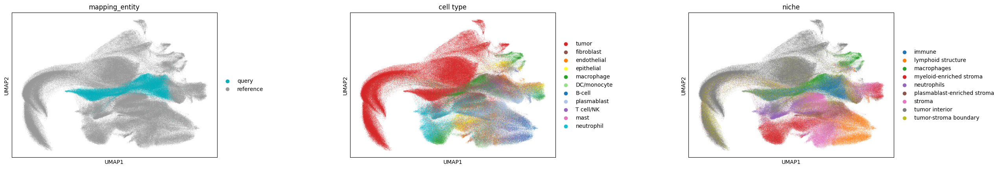

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.01
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1494, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960


In [5]:
# 13 (grey), 5 (green)
madata = load_model('102')

In [ ]:
madata.__dict__

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/pyth

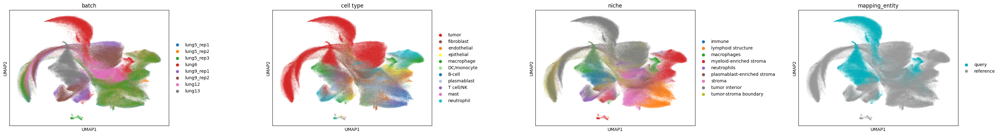

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


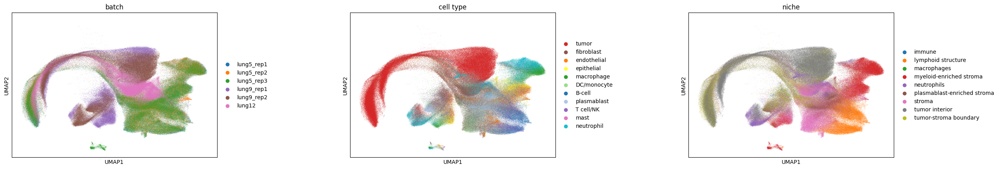

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


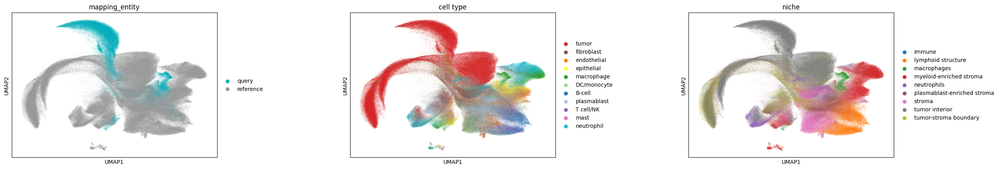

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


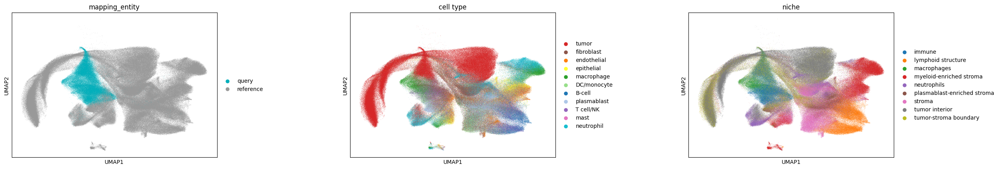

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.01
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1494, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960


In [72]:
# 6 red, 13 grey
madata = load_model('103')

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/pyth

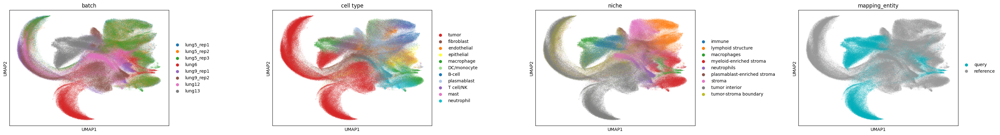

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


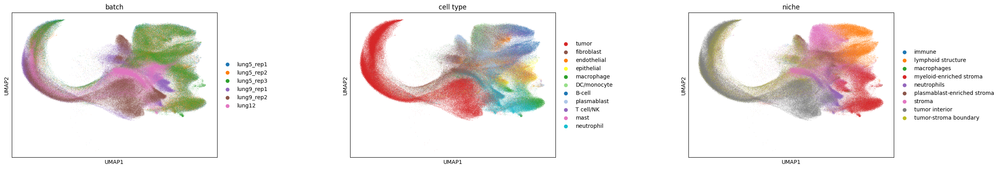

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


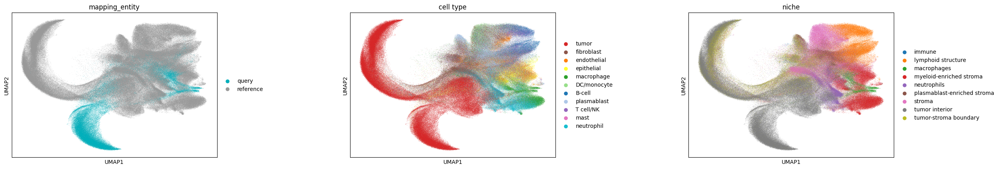

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


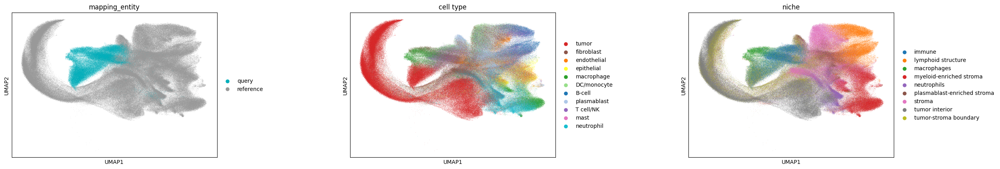

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.01
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1494, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960


In [73]:
# 6 red, 13 grey
madata = load_model('104')

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/pyth

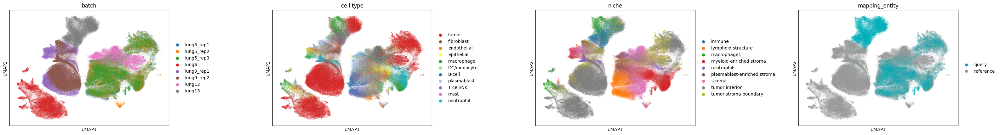

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


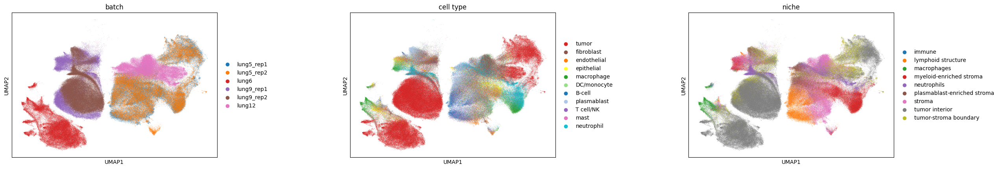

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


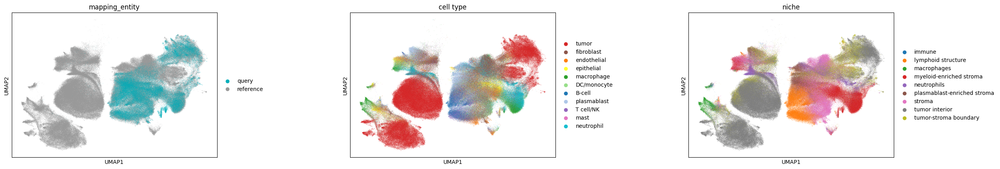

/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/irene.bonafonte/miniforge3/envs/nichecompass/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


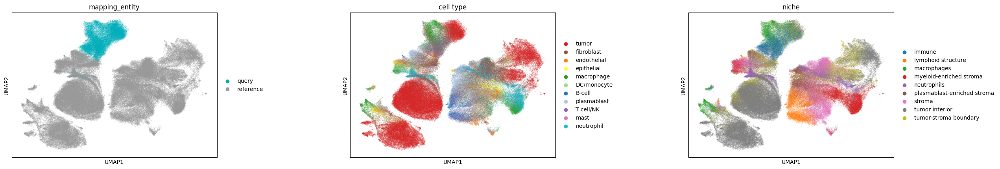

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.01
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1494, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1494, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960


In [74]:
# 5 green, 13 grey
madata = load_model('105')

# Visualize and cluster

In [ ]:
mdata = load_model('1', cluster=True, latent_leiden_resolution=0.5)

In [54]:
latent_leiden_resolution=0.5
model_folder = glob.glob(f'../../../artifacts/{dataset}/models/{model}/*_1')[0]
adata = sc.read_h5ad(f"{model_folder}/{dataset}_{model}.h5ad")

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


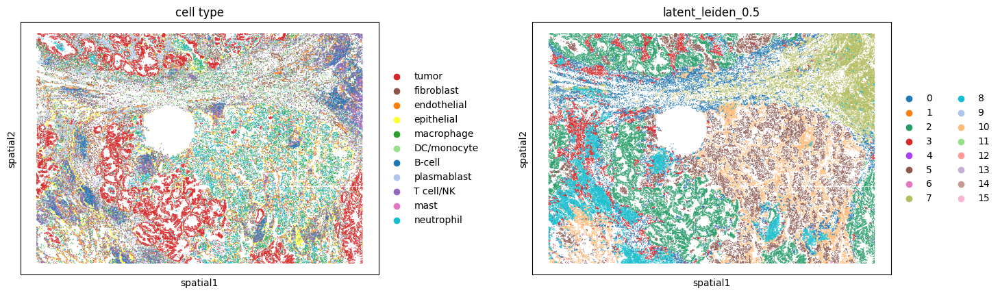

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


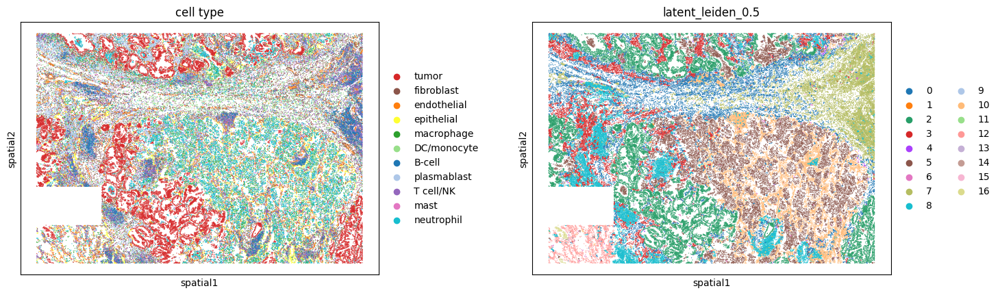

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


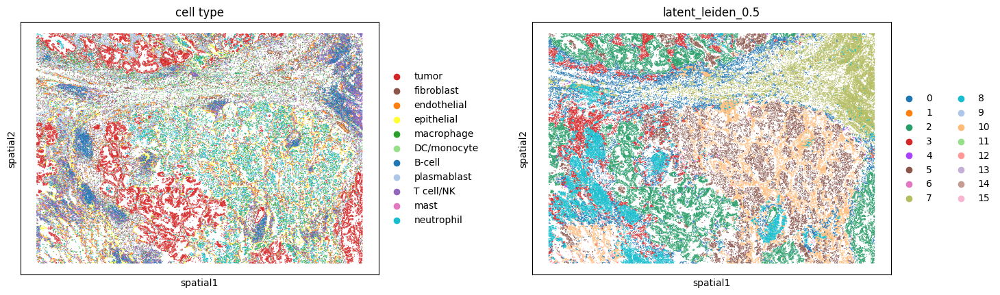

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


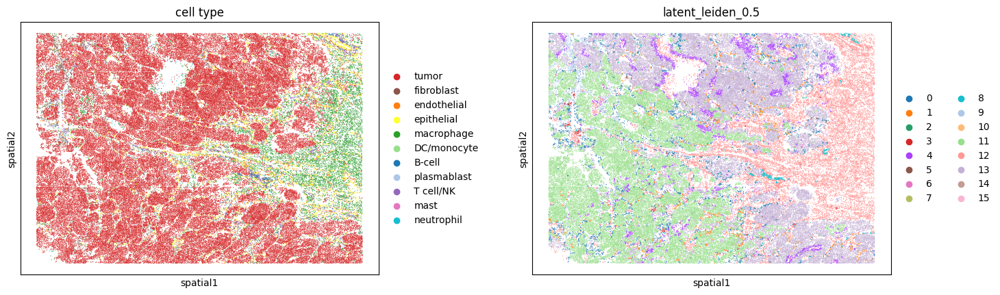

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


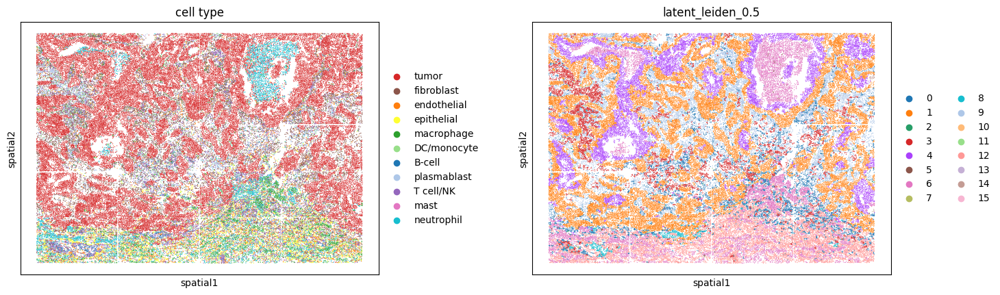

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


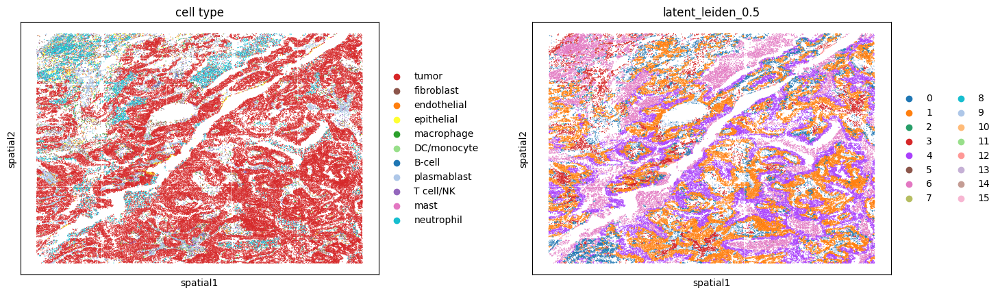

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


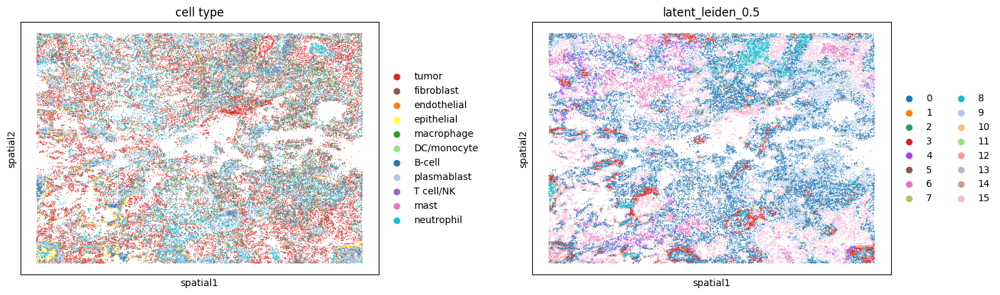

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


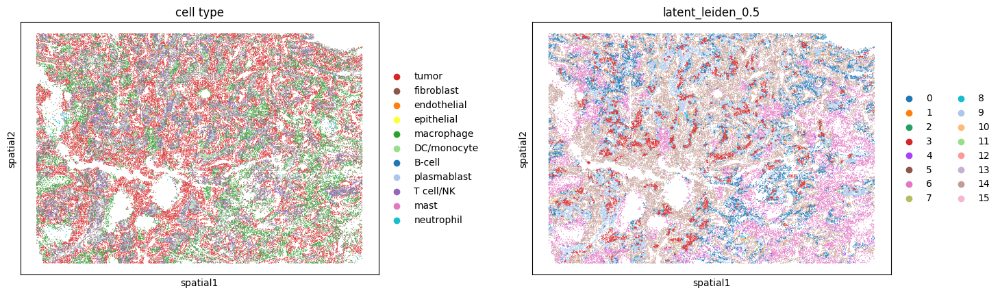

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.03
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1613, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1613, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1613, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
717 active GPs out of 1713 total GPs.


In [55]:
# for b in adata.obs.loc[adata.obs['patient']=='Lung5','batch'].unique():
for b in adata.obs.batch.unique():
    sc.pl.embedding(adata[adata.obs.batch==b], basis="spatial", color=['cell type', f"latent_leiden_{str(latent_leiden_resolution)}"], ncols=2, wspace=0.3, size=3)    

adata = NicheCompass.load(dir_path=model_folder,
                  adata=adata,
                  gp_names_key='nichecompass_gp_names')

# check number of active gps
active_gps = adata.get_active_gps()
print(f"{len(active_gps)} active GPs out of {len(adata.adata.uns['nichecompass_gp_names'])} total GPs.")


/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


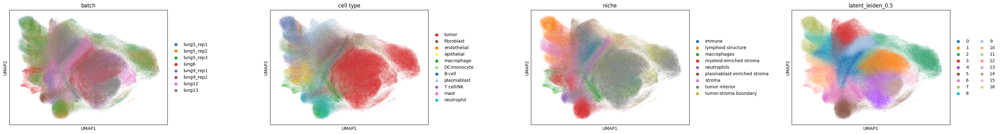

In [56]:
sc.pl.umap(adata.adata, color=['batch','cell type','niche',f"latent_leiden_{str(latent_leiden_resolution)}"], ncols=4, wspace=0.5, size=0.5)

In [ ]:
mdata = load_model('24', cluster=True, latent_leiden_resolution=0.5)

In [ ]:
model_folder = glob.glob(f'../../../artifacts/{dataset}/models/{model}/*_25')[0]
adata = sc.read_h5ad(f"{model_folder}/{dataset}_{model}.h5ad")

In [59]:
latent_leiden_resolution=0.5
model_folder = glob.glob(f'../../../artifacts/{dataset}/models/{model}/*_24')[0]
adata = sc.read_h5ad(f"{model_folder}/{dataset}_{model}.h5ad")

adata = NicheCompass.load(dir_path=model_folder,
                  adata=adata,
                  gp_names_key='nichecompass_gp_names')

# check number of active gps
active_gps = adata.get_active_gps()
print(f"{len(active_gps)} active GPs out of {len(adata.adata.uns['nichecompass_gp_names'])} total GPs.")

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.03
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1613, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1613, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1613, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
311 active GPs out of 1713 total GPs.


/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


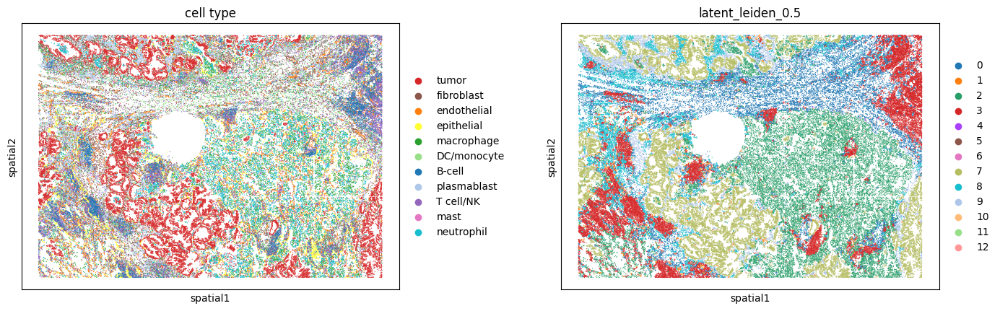

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


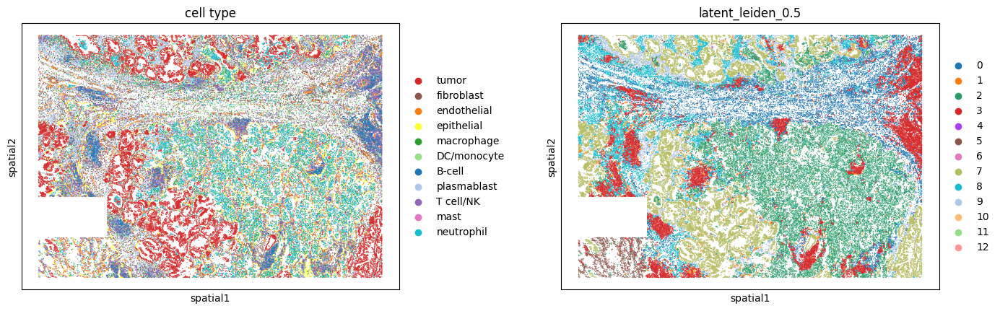

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


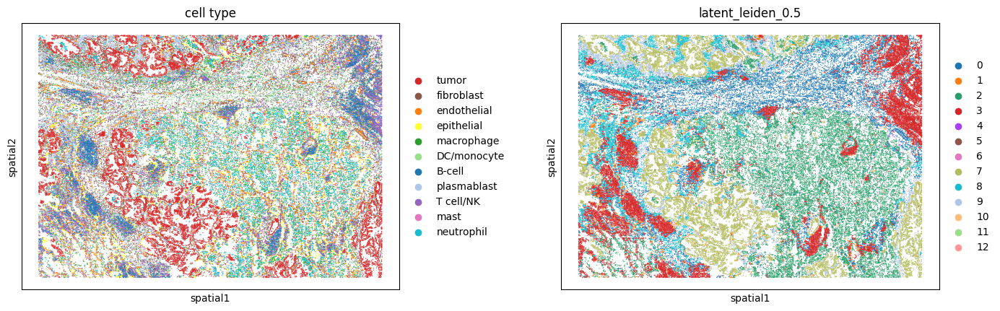

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


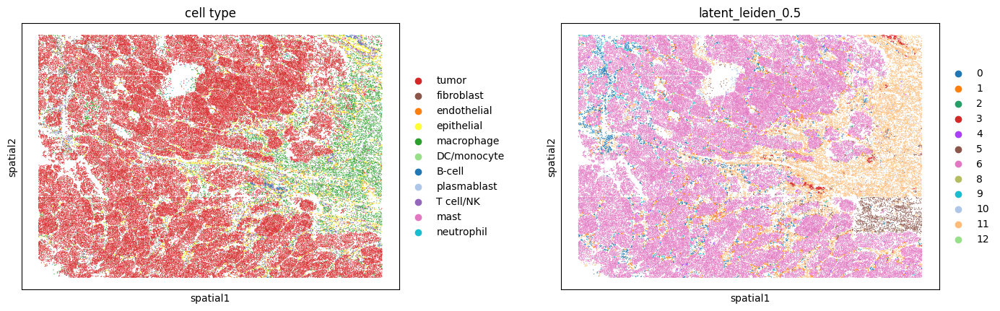

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


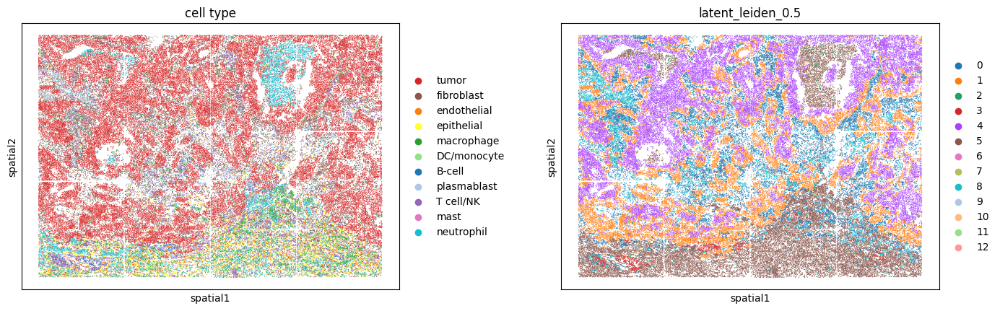

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


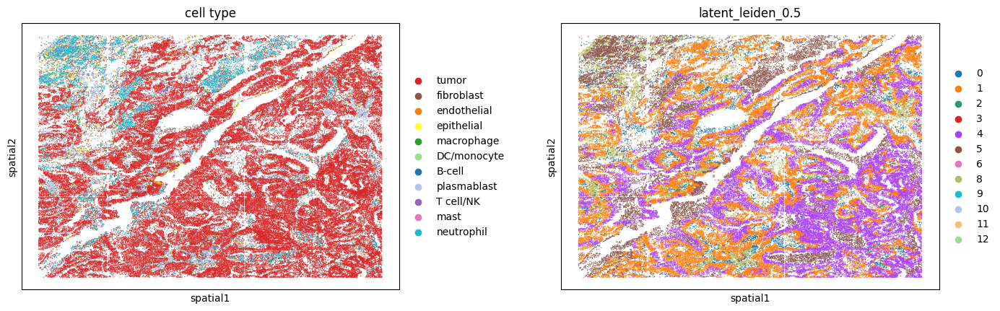

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


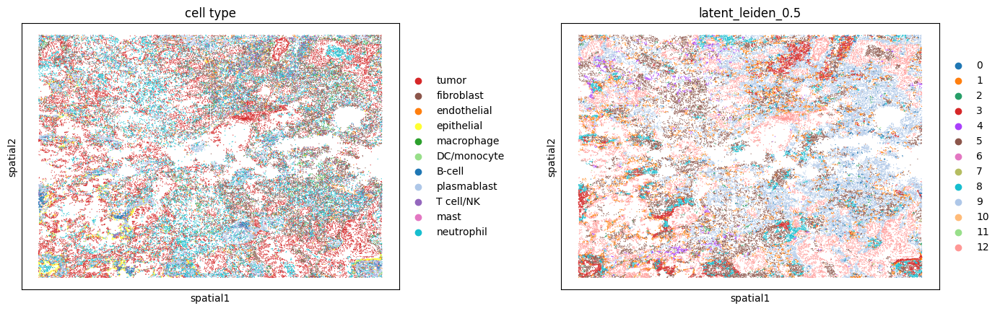

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


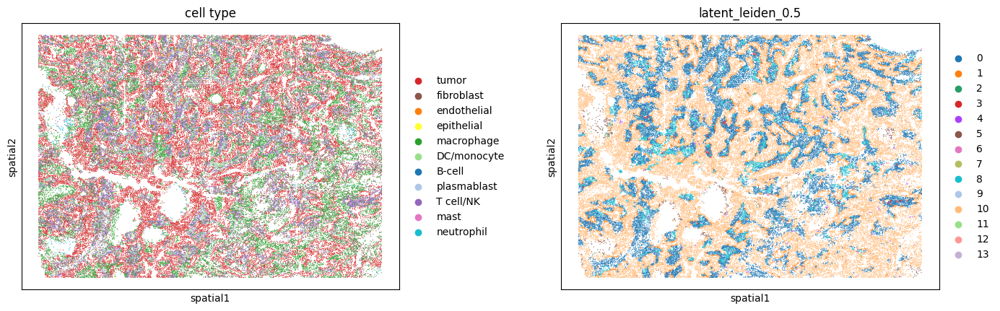

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.03
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1613, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1613, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1613, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
311 active GPs out of 1713 total GPs.


In [58]:
# for b in adata.obs.loc[adata.obs['patient']=='Lung5','batch'].unique():
for b in adata.obs.batch.unique():
    sc.pl.embedding(adata[adata.obs.batch==b], basis="spatial", color=['cell type', f"latent_leiden_{str(latent_leiden_resolution)}"], ncols=2, wspace=0.3, size=3)    

adata = NicheCompass.load(dir_path=model_folder,
                  adata=adata,
                  gp_names_key='nichecompass_gp_names')

# check number of active gps
active_gps = adata.get_active_gps()
print(f"{len(active_gps)} active GPs out of {len(adata.adata.uns['nichecompass_gp_names'])} total GPs.")


In [2]:
import glob
import scanpy as sc
from nichecompass.models import NicheCompass

In [3]:
dataset = 'nanostring_cosmx_human_nsclc'
model_type = 'reference'

In [5]:
model_folder = glob.glob(f'../../../artifacts/{dataset}/models/{model_type}/*_25')[0]
adata = sc.read_h5ad(f"{model_folder}/{dataset}_{model_type}.h5ad")

adata = NicheCompass.load(dir_path=model_folder,
                  adata=adata,
                  gp_names_key='nichecompass_gp_names')

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.03
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1613, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1613, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1613, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960


In [4]:
for suffix in [24,25,26,27,28,29,30,1]:
    model_folder = glob.glob(f'../../../artifacts/{dataset}/models/{model_type}/*_{suffix}')[0]
    adata = sc.read_h5ad(f"{model_folder}/{dataset}_{model_type}.h5ad")

    adata = NicheCompass.load(dir_path=model_folder,
                      adata=adata,
                      gp_names_key='nichecompass_gp_names')

    # check number of active gps
    active_gps = adata.get_active_gps()
    print(f"{len(active_gps)} active GPs out of {len(adata.adata.uns['nichecompass_gp_names'])} total GPs.")

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.03
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1613, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1613, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1613, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
311 active GPs out of 1713 total GPs.
--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH A

/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.03
LOG VARIATIONAL -> True
CATEGORICAL COVARIATES EMBEDDINGS INJECTION -> ['gene_expr_decoder']
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 960, n_cat_covariates_embed_input: 0, n_hidden: 960, n_latent: 1613, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, use_bn: False
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 1613, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 1613, n_addon_gp_input: 100, n_cat_covariates_embed_input: 38, n_output: 960
295 active GPs out of 1713 total GPs.
--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH A

In [1]:
import glob
import scanpy as sc
from nichecompass.models import NicheCompass

In [3]:
dataset = 'nanostring_cosmx_human_nsclc'
model_type = 'reference_query_mapping'

In [7]:
suffix=27
model_folder = glob.glob(f'../../../artifacts/{dataset}/models/{model_type}/*_{suffix}')[0]
adata = sc.read_h5ad(f"{model_folder}/{dataset}_{model_type}.h5ad")
adata.obs[['batch','mapping_entity']].value_counts()

batch       mapping_entity
lung9_rep2  reference         115676
lung5_rep2  reference          97487
lung5_rep1  reference          93206
lung5_rep3  query              91691
lung6       reference          83723
lung9_rep1  reference          77391
lung12      reference          66489
dtype: int64

In [6]:
suffix=28
model_folder = glob.glob(f'../../../artifacts/{dataset}/models/{model_type}/*_{suffix}')[0]
adata = sc.read_h5ad(f"{model_folder}/{dataset}_{model_type}.h5ad")
adata.obs[['batch','mapping_entity']].value_counts()

batch       mapping_entity
lung9_rep2  reference         115676
lung5_rep2  reference          97487
lung5_rep1  reference          93206
lung5_rep3  query              91691
lung6       reference          83723
lung9_rep1  reference          77391
lung12      reference          66489
dtype: int64

# Metrics
this does not run - run with a slurm job per model with the nsclc_integration_metrics.py scripts

In [1]:
from nichecompass.benchmarking import compute_benchmarking_metrics
import anndata as ad
import pandas as pd
import scanpy as sc
import glob

No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


In [26]:
dataset = 'nanostring_cosmx_human_nsclc'
model_type = 'reference'
available_models = glob.glob(f'../../../artifacts/{dataset}/models/{model_type}/*')
cell_type_key='cell_type'
batch_key='batch'
latent_key='nichecompass_latent'
metrics=['gcs', 'mlami', 'cas', 'clisis', 'nasw', 'cnmi', 'cari', 'casw', 'clisi', 'basw', 'bgc', 'blisi']

In [ ]:
# Initialize metrics dicts
benchmark_dict_acc = {metric: [] for metric in ['run_number']+metrics}

for model in available_models:
    print(model)
    results_path = model.replace('models','results')
    model_label = model.split('/')[-1]
    benchmark_dict_acc['run_number'].append(model)
    
    # Load
    adata = sc.read_h5ad(f'{model}/{dataset}_{model_type}.h5ad')
    
    benchmark_dict = compute_benchmarking_metrics(
        adata=adata,
        metrics=metrics,
        cell_type_key=cell_type_key,
        batch_key=batch_key,
        spatial_key='spatial',
        latent_key=latent_key,
        n_jobs=1,
        seed=0,
        mlflow_experiment_id=None)

    for key, value in benchmark_dict.items():
        benchmark_dict_acc[key].append(value)

benchmark_dict_acc = pd.DataFrame(benchmark_dict_acc)

../../../artifacts/nanostring_cosmx_human_nsclc/models/reference/05102023_213259_9


/home/icb/irene.bonafonte/miniconda3/envs/nichecompass-reproducibility/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Computing spatial nearest neighbor graph with 15 neighbors for entire dataset...
Computing spatial nearest neighbor graph with 90 neighbors for entire dataset...
Computing latent nearest neighbor graph with 15 neighbors for entire dataset...


In [3]:
import pandas as pd
import glob
import os

# load
dataset = 'nanostring_cosmx_human_nsclc'
model_type = 'reference'
available_models = glob.glob(f'../../../artifacts/{dataset}/results/{model_type}/*')
metrics = []
model_name = []
for model in available_models:
    if os.path.exists(f"{model}/scbi_metrics_m.csv"):
        metrics.append(pd.read_csv(f"{model}/scbi_metrics_m.csv"))
        model_name.append(model.split('/')[-1])
        
    elif os.path.exists(f"{model}/scbi_metrics.csv"):
        metrics.append(pd.read_csv(f"{model}/scbi_metrics.csv"))
        model_name.append(model.split('/')[-1])

metrics = pd.concat(metrics)
metrics = metrics.iloc[[i for i in range(0, len(metrics), 2)],1:]
metrics.index = model_name

In [5]:
metrics.sort_values(by='iLISI', ascending=False)

,Silhouette label,cLISI,Silhouette batch,iLISI,KBET,PCR comparison,Batch correction,Bio conservation,Total
05102023_213259_5,0.4787241015583277,0.9284740447998047,0.8938051,0.14153991426740373,0.07147919319593878,0.976432263970994,0.5208141145117595,0.7035990731790662,0.6304850897121435
30092023_022140_303,0.5116096353158355,0.9476466655731202,0.88646257,0.13441637584141322,0.08513370149093072,0.967009261882194,0.5182554771128234,0.7296281504444778,0.6450790811118161
06102023_193136_25,0.4958027182146907,0.9224518656730651,0.90395474,0.11659457002367292,0.07591100347188812,0.9810138346018124,0.5193685381090907,0.7091272919438779,0.633223790409963
06102023_193136_23,0.4904475770890713,0.9296707034111023,0.9059002,0.10991975239345006,0.06150009149229492,0.9821035241493382,0.5148558870937241,0.7100591402500868,0.6319778389875417
06102023_193048_26,0.4962099939584732,0.9357525110244751,0.9072155,0.09648135730198451,0.06553150393599669,0.9735511250301077,0.5106948655760402,0.7159812524914742,0.6338666977253005
05102023_213300_1,0.4949647393077612,0.9348505735397339,0.9134924,0.09389686584472656,0.061576288561012466,0.9809626757816694,0.5124820529400329,0.7149076564237475,0.6339374150302617
06102023_173137_24,0.497357563348487,0.9358119130134582,0.9208014,0.08916873591286796,0.06821496368094836,0.9550062923094347,0.5082978482603892,0.7165847381809727,0.6332699822127392
06102023_193137_22,0.49456504033878446,0.9303584098815918,0.9215205,0.08587382520948138,0.061813528352727354,0.981404469062346,0.5126530735493577,0.7124617251101881,0.6325382644858559
30092023_022140_301,0.49862414703238755,0.9428260087966919,0.9345531,0.08433127403259277,0.06417342360590468,0.9572045120164587,0.510065574103154,0.7207250779145398,0.6364612763899855
06102023_193137_21,0.49530013697221875,0.9402634024620056,0.9286075,0.08089767183576312,0.05753409173461942,0.9536069576126248,0.5051615611560805,0.7177817697171122,0.6327336862926994
